# Cell type assignment

In this notebook, we analyse the cell type predictions of the automated annotation model and assign cell types using marker gene expression and other sources of information (e.g. knowledge of developmental stages and anatomical dissections).  

This was an interactive and collaborative effort and so the code provided below does not mirror the annotation process exactly. However, it illustrates the general approaches used and details the final cluster assignments, defining the cell types annotated in the rabbit atlas.  

## Setup

In [2]:
import scrabbit
from scrabbit.annotate import *
from scrabbit.plot_utils import *
import scanpy as sc
import pandas as pd
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt
import math
from ipywidgets.widgets import HBox

seed = 0
seedB = 42

sc.set_figure_params(dpi=150,dpi_save=300)

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


## Load data

In [2]:
# Load data
r_data = sc.read_h5ad("data-in/r_umap_leiden.h5ad")
rm_orthologs = pd.read_csv("data-in/rm_orthologs.tsv", sep="\t")

In [57]:
# Add somite count info
r_data.obs["somite_count"] = "0"
r_data.obs["somite_count"][r_data.obs["sample"].isin([7,8,9])] = "4"
r_data.obs["somite_count"][r_data.obs["sample"].isin([12,13,14,15])] = "13"
r_data.obs["somite_count"][r_data.obs["sample"].isin([16,17,18,19])] = "16"
r_data.obs["somite_count"][r_data.obs["sample"].isin([20,21,22])] = "11"
r_data.obs["somite_count"][r_data.obs["sample"].isin([23,24,25,26])] = "19"
r_data.obs["somite_count"][r_data.obs["sample"].isin([1,2,3,4,5,6,10,11])] = "0"

<ipython-input-57-d90574641929>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  r_data.obs["somite_count"][r_data.obs["sample"].isin([7,8,9])] = "4"
<ipython-input-57-d90574641929>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  r_data.obs["somite_count"][r_data.obs["sample"].isin([12,13,14,15])] = "13"
<ipython-input-57-d90574641929>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  r_data.obs["somite_count"][r_data.obs["sample"].isi

In [5]:
# TODO add this as default for r_data
#r_data.obs["anatomical_loc"] = r_data.obs["anatomical_loc"].astype("str")
r_data.obs["anatomical_loc"] = ""

# Add anatomical location info
r_data.obs["anatomical_loc"][r_data.obs["sample"].isin([12,16])] = "Head"
r_data.obs["anatomical_loc"][r_data.obs["sample"].isin([13,17])] = "Trunk"
r_data.obs["anatomical_loc"][r_data.obs["sample"].isin([14,18])] = "Tail"
r_data.obs["anatomical_loc"][r_data.obs["sample"].isin([15,19,22,26])] = "Yolk sac"
r_data.obs["anatomical_loc"][~r_data.obs["sample"].isin([12,16,13,17,14,18,15,19,22,26])] = "Whole embryo"
r_data.obs["anatomical_loc"] = r_data.obs["anatomical_loc"].astype("category")
r_data.obs["anatomical_loc"] = r_data.obs["anatomical_loc"].cat.reorder_categories(["Head", "Trunk", 
                                                                                    "Tail","Yolk sac",
                                                                                    "Whole embryo"])
anatomy_colours = {
    "Head":"red",
    "Trunk": "blue",
    "Tail": "green",
    "Yolk sac": "orange",
    "Whole embryo": "grey"
}

r_data.uns["anatomical_loc_colors"] = [anatomy_colours[x] for x in r_data.obs["anatomical_loc"].cat.categories]

C:\Users\DANIEL~1\AppData\Local\Temp/ipykernel_12044/1539020577.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  r_data.obs["anatomical_loc"][r_data.obs["sample"].isin([12,16])] = "Head"
C:\Users\DANIEL~1\AppData\Local\Temp/ipykernel_12044/1539020577.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  r_data.obs["anatomical_loc"][r_data.obs["sample"].isin([13,17])] = "Trunk"
C:\Users\DANIEL~1\AppData\Local\Temp/ipykernel_12044/1539020577.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/

In [6]:
# Load cell type markers
m_markers = pd.read_csv("data-in/celltype_markers.tsv", sep="\t")
m_markers = {i: m_markers[i].dropna().to_list() for i in m_markers.columns}

In [7]:
# Get rabbit gene names from mouse markers
orthologs_copy = rm_orthologs
orthologs_copy.index = orthologs_copy["mouse_gene_name"]
r_markers = {i: list(orthologs_copy.loc[[x for x in m_markers[i] if x in orthologs_copy["mouse_gene_name"]] ,"rabbit_gene_name"]) for i in list(m_markers.keys())  }

## Divide dataset

To simplify the annotation process, the dataset is initially divded into broad regions to be annotated separately. 

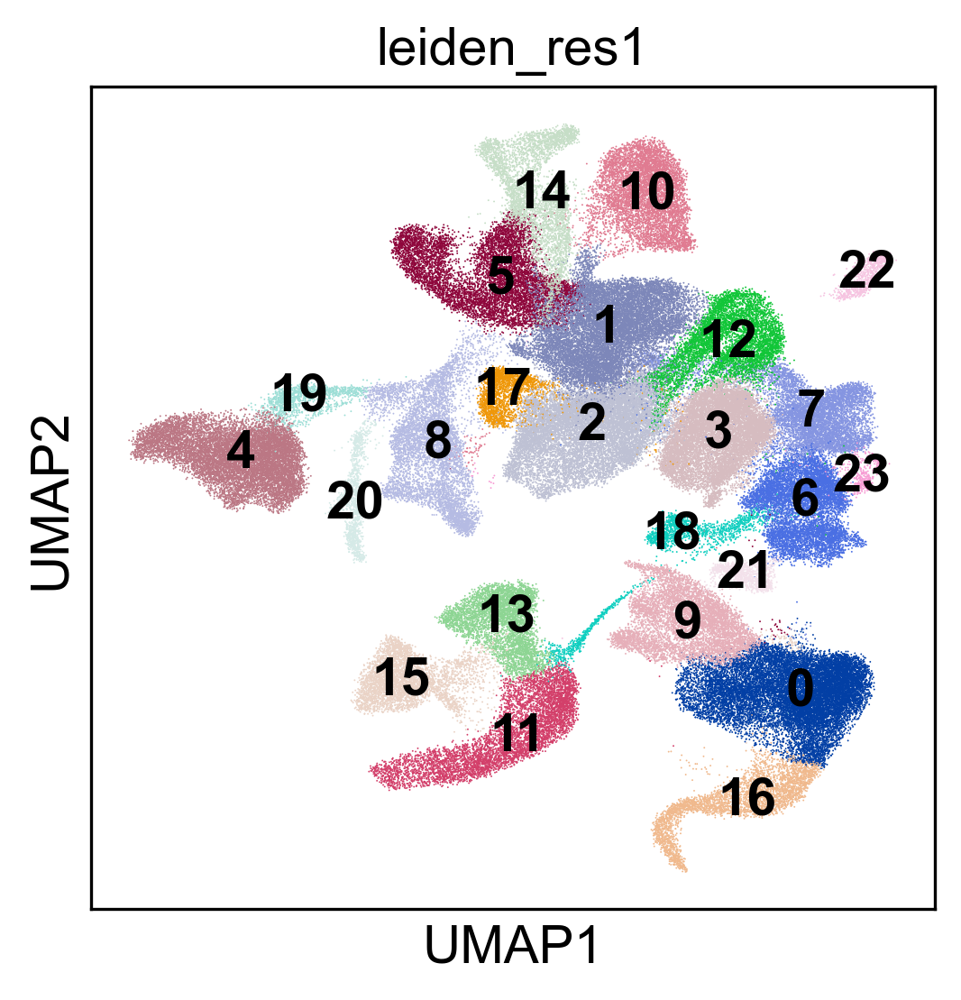

In [ ]:
sc.pl.umap(r_data,color=["leiden_res1"],legend_loc="on data")

In [ ]:
r_blood = r_data[r_data.obs["leiden_res1"].isin(['4','19','20','8']),]
r_meso = r_data[r_data.obs["leiden_res1"].isin(['2','12','22','1']),]
r_neural = r_data[r_data.obs["leiden_res1"].isin(['3']),]
r_misc = r_data[r_data.obs["leiden_res1"].isin(['6','23','18','7','17']),]
r_exeMeso = r_data[r_data.obs["leiden_res1"].isin(['5','14','10']),]
r_hypo = r_data[r_data.obs["leiden_res1"].isin(['13','15','11']),]
r_tropho = r_data[r_data.obs["leiden_res2"].isin(['0','17','18','26','12','30','20']),]

## Within lineage clustering

In [976]:
# Mesoderm
sc.tl.leiden(r_meso, resolution=5, key_added="mesoderm_leiden_res5",random_state=seed)

In [816]:
# Blood
sc.tl.leiden(r_blood, resolution=1, key_added="blood_leiden_res1", random_state = seed)
sc.tl.leiden(r_blood, resolution=8, key_added="blood_leiden_res8", random_state = seed)

Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [817]:
# ExE mesoderm
sc.tl.leiden(r_exeMeso,resolution=1,key_added="exeMeso_leiden_res1",random_state=seed)

Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [ ]:
# Neural
sc.tl.leiden(r_neural,resolution=3,key_added="neural_leiden_res3",random_state=seed)

In [ ]:
# Misc
sc.tl.leiden(r_misc,resolution=3,key_added="misc_leiden_res3",random_state=seed)
sc.tl.leiden(r_misc,resolution=4,key_added="misc_leiden_res4",random_state=seed)

## Useful plots

For each broad region, we plot the automated annotation predictions, along with clusterings of different resolutions. These results are compared to UMAP plots of marker gene expression and are cross-validated with other sources of information such as the developmental stage and anatomical dissection.


<AxesSubplot:title={'center':'anatomical_loc'}, xlabel='UMAP1', ylabel='UMAP2'>

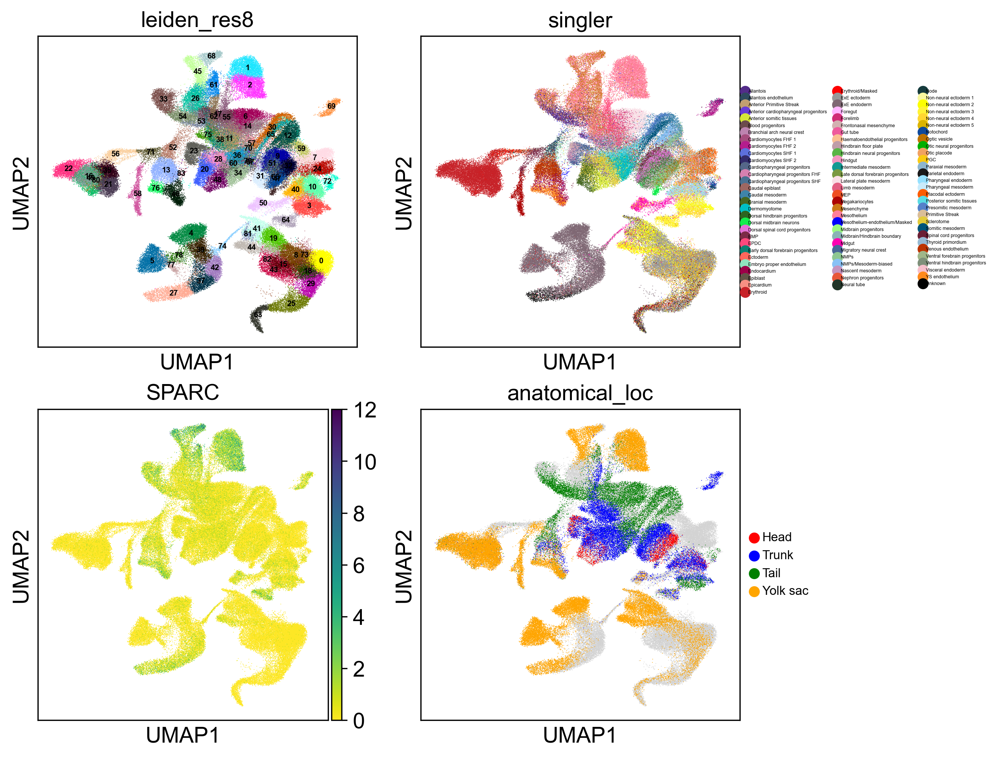

In [229]:
fig, axs = plt.subplots(2, 2,figsize=(8,8))

sc.pl.umap(r_data,color=["leiden_res8"],legend_loc="on data",legend_fontsize=5,ax=axs[0,0],show=False)
sc.pl.umap(r_data,color=["singler"],legend_fontsize=3,ax=axs[0,1],show=False)
sc.pl.umap(r_data,color=r_markers["Yolk sac endothelium"][1],color_map="viridis_r",ax=axs[1,0],show=False)
sc.pl.umap(r_data,color=["anatomical_loc"],groups=["Head","Trunk","Tail","Yolk sac"],legend_fontsize=8,ax=axs[1,1],show=False)


#frac_plot = plotObsFraction(r_data,"")

It's also informative to plot the frequency distribution of cell type predictions within each cluster. Since the annotation model makes predictions independently for each cell, if there are clusters of cells with a dominant cell type prediction, it may be suggestive of a reliable annotation. Similarly, we can plot the distribution across clusters for each predicted cell type label. 

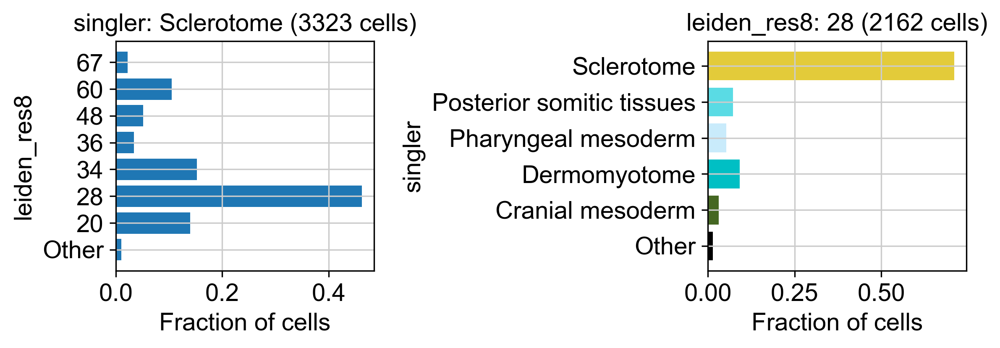

In [26]:
fig, axs = plt.subplots(1, 2,figsize=(8,3))

plotObsFraction(r_data,obA="Sclerotome", obsA = "singler", obsB = "leiden_res8", 
                     obsA_ignore_thresh = 50 , obsB_ignore_thresh = 0.02,ax=axs[0])

plotObsFraction(r_data,obA="28", obsA = "leiden_res8", obsB = "singler", 
                    obsA_ignore_thresh = 50 , obsB_ignore_thresh = 0.02,ax=axs[1],
                obsB_colours=getCelltypePalette())
    

#plt.savefig("G:/My Drive/Postgrad/PhD/Assessments/Second year report/figs/src/cluster_fractions.pdf", dpi=300)

Finally, it can also be informative to visualise the embeddings in 3D (using `plotObsUMAP3d`) to reveal structure that may be obfuscated in 2D. 

## Make annotation plots 

We can produce the 2D figures above for each broad region, and for each clustering.  First we do this looking at the whole dataset before then focussing in on each region. 

### Whole dataset

In [ ]:
Path("../figs/celltype_annotation/annotation_pipeline/whole_dataset/").mkdir(parents=True, exist_ok=True)
makeAnnotationPlots(r_data, 
                    clusters = ["leiden_res8"],
                    model_predictions = "singler",
                   markers = r_markers,
                    other_obs = ["stage","anatomical_loc"],
                   export_dir = "../figs/celltype_annotation/annotation_pipeline/whole_dataset/")

### Mesoderm

In [48]:
# Create directory for mesoderm region
#Path("../figs/celltype_annotation/annotation_pipeline/r_meso/").mkdir(parents=True, exist_ok=True)

# Filter cell type marker genes to query
mesoderm_celltypes = ["Anterior cardiopharyngeal progenitors","Anterior somitic tissues","Branchial arch neural crest",
                     "Cardiomyocytes FHF 1", "Cardiomyocytes FHF 2", "Cardiomyocytes SHF 1","Cardiomyocytes SHF 2",
                     "Cardiopharyngeal progenitors", 'Cardiopharyngeal progenitors SHF','Cranial mesoderm',
                     "Dermomyotome","Epicardium","ExE mesoderm","Frontonasal mesenchyme","Kidney",'Lateral plate mesoderm','Limb mesoderm',
                     "Mesenchyme","Migratory neural crest","Myocardium",'Nephron progenitors','Posterior somitic tissues','Sclerotome']

makeAnnotationPlots(r_meso, 
                    clusters = ["leiden_res8", "mesoderm_leiden_res2","mesoderm_leiden_res3"],
                    model_predictions = "singler", other_obs=["stage","anatomical_loc"],
                   markers = {k: r_markers[k] for k in mesoderm_celltypes},
                   export_dir = "../figs/celltype_annotation/annotation_pipeline/r_meso/")

### Blood

In [335]:
# Create directory for mesoderm region
Path("../figs/celltype_annotation/annotation_pipeline/r_blood/").mkdir(parents=True, exist_ok=True)

# Filter out cell types unlikely to be in blood region 
blood_celltypes = ['Allantois endothelium','Embryo proper endothelium','EMP','Endocardium',
                   'Megakaryocyte progenitors','MEP','Venous endothelium','Yolk sac endothelium']


makeAnnotationPlots(r_blood, 
                    clusters = ["leiden_res8", "blood_leiden_res1","blood_leiden_res8"],
                    model_predictions = "singler", other_obs=["stage","anatomical_loc"],
                   markers = {k: r_markers[k] for k in blood_celltypes},
                   export_dir = "../figs/celltype_annotation/annotation_pipeline/r_blood/")


## Exploratory analysis

### Mesoderm

In [984]:
meso_umap3D = sc.pp.neighbors(r_meso,n_neighbors=50, use_rep="X_pca", random_state=seed, copy=True)
meso_umap3D = sc.tl.umap(meso_umap3D, min_dist=0.5, n_components=3, random_state=seed, copy=True)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [985]:
meso_umap3D.obs["mesoderm_leiden_res3"] = r_meso.obs["meso_leiden_res3"]

In [ ]:
# Compare SingleR annotations against clusters in 3D
fig1 = plotObsUMAP3d(meso_umap3D,"singler",
                     hover_obs=["mesoderm_leiden_res3","singler","anatomical_loc","stage","leiden_res8"],
                     colour_map=scrabbit.plot_utils.getCelltypePalette(),figsize=(700,700))
fig2 = plotObsUMAP3d(meso_umap3D,"mesoderm_leiden_res3",
                     hover_obs=["mesoderm_leiden_res3","singler","anatomical_loc","stage","leiden_res8"],
                     figsize=(700,700))
HBox([go.FigureWidget(fig1), go.FigureWidget(fig2)])

### Blood

In [336]:
# Compute 3D UMAP
blood_umap3D = sc.pp.neighbors(r_blood,n_neighbors=50, use_rep="X_pca", random_state=seed, copy=True)
blood_umap3D = sc.tl.umap(blood_umap3D, min_dist=0.5, n_components=3, random_state=seed, copy=True)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
C:\anaconda\envs\rabbit-gastrulation-python\lib\site-packages\scanpy\neighbors\__init__.py:121: FutureWarning:

This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.

C:\anaconda\envs\rabbit-gastrulation-python\lib\site-packages\scanpy\neighbors\__init__.py:122: FutureWarning:

This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
C:\anaconda\envs\rabbit-gastrulation-python\lib\site-packages\scanpy\tools\_umap.py:147: FutureWarning:

This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.



In [471]:
# Compare SingleR annotations against clusters in 3D
fig1 = plotObsUMAP3d(blood_umap3D,"singler",hover_obs=["singler","blood_leiden_res8","anatomical_loc","stage","leiden_res8"],
                    colour_map=scrabbit.plot_utils.getCelltypePalette(),figsize=(700,700))
fig2 = plotObsUMAP3d(blood_umap3D,"blood_leiden_res8",
                     hover_obs=["blood_leiden_res8","singler","anatomical_loc","stage","leiden_res8"],
                     figsize=(700,700))
HBox([go.FigureWidget(fig1), go.FigureWidget(fig2)])


    'data': [{'customdata': [['Allantois endothelium', '5', 'Whole embryo', 'GD7…

### Extra-embryonic mesoderm

In [492]:
sc.tl.leiden(r_exeMeso,resolution=1,key_added="exeMeso_leiden_res1",random_state=seed)

Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [996]:
# Compute 3D UMAP
exeMeso_3d = sc.pp.neighbors(r_exeMeso,n_neighbors=50, use_rep="X_pca", random_state=seed, copy=True)
exeMeso_3d = sc.tl.umap(exeMeso_3d, min_dist=0.5, n_components=3, random_state=seed, copy=True)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [ ]:
# Compare SingleR annotations against clusters in 3D
fig1 = plotObsUMAP3d(exeMeso_3d,"singler",
                     hover_obs=["singler","exeMeso_leiden_res1","anatomical_loc","stage","leiden_res8"],
                    colour_map=scrabbit.plot_utils.getCelltypePalette(),figsize=(700,600))

fig2 = plotObsUMAP3d(exeMeso_3d,"exeMeso_leiden_res1",
                     hover_obs=["exeMeso_leiden_res1","singler","anatomical_loc","stage","leiden_res8"],
                     figsize=(700,600))
HBox([go.FigureWidget(fig1), go.FigureWidget(fig2)])


### Neural

In [420]:
sc.tl.leiden(r_neural,resolution=3,key_added="neural_leiden_res3",random_state=seed)

In [69]:
neural_3d = sc.pp.neighbors(r_neural,n_neighbors=25, use_rep="X_pca", random_state=seed, copy=True)
neural_3d = sc.tl.umap(neural_3d, min_dist=0.5, n_components=3, random_state=seed, copy=True)
neural_3d.obs["neural_leiden_res3"] = r_neural.obs["neural_leiden_res3"]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Forebrain: OTX2+, FEZF1/2+, SIX6+; <br>
Midbrain: OTX2+, FEZF2-, HOXA2-; <br>
Hindbrain: HOXA2+, HOXA7-, HOXB9-, OTX2 <br>

In [ ]:
# Clusters 6, 0, 13 - Spinal cord HOXA9+/HOXA7+/hoxb9+
sc.pl.umap(r_neural,color=["neural_leiden_res3","HOXA9","HOXA7","HOXB9"], color_map="viridis_r",legend_loc="on data")

In [ ]:
# Clusters 1, 8, 18, 4, 20, 21, 3, 11 - Hindbrain HOXA7-/HOXB9-/OTX2-/HOXA2+
sc.pl.umap(r_neural,color=["neural_leiden_res3","HOXA7","HOXB9","OTX2","HOXA2"], color_map="viridis_r",legend_loc="on data")

In [ ]:
# Clusters 12, 19, 10, 7 - Midbrain OTX2+/FEZF2-/HOXA2-
sc.pl.umap(r_neural,color=["neural_leiden_res3","FEZF1","FEZF2","SIX6","OTX2","HOXA2"], color_map="viridis_r",legend_loc="on data")

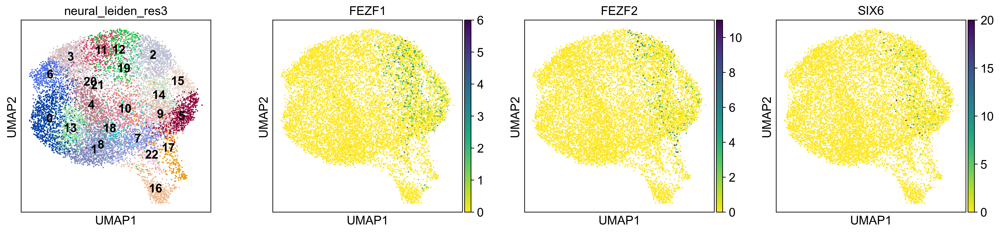

In [448]:
# Clusters 2, 15, 5, 9, 14 - Forebrain FEZF+/SIX6+
sc.pl.umap(r_neural,color=["neural_leiden_res3","FEZF1","FEZF2","SIX6"], color_map="viridis_r",legend_loc="on data")

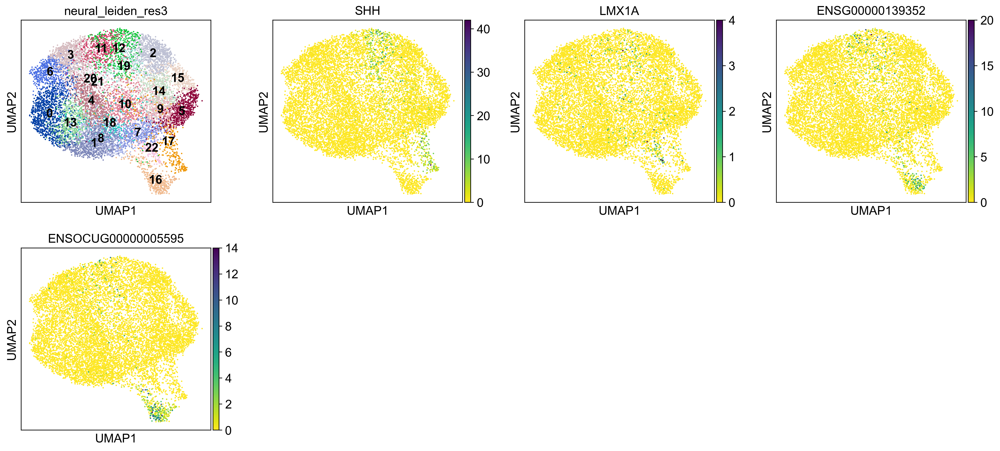

In [467]:
# Cluster 6 - roof plate LMX1A+
# Cluster 13 - floor plate SHH+
# Cluster 12 - Differentiating neurons (ENSG00000139352)ASCL1+ / ENSOCUG00000005595(NEUROD4)+
sc.pl.umap(r_neural,color=["neural_leiden_res3","SHH","LMX1A","ENSG00000139352","ENSOCUG00000005595"], color_map="viridis_r",legend_loc="on data")

In [ ]:
# 3D visualisation
fig1 = fig1 = plotObsUMAP3d(neural_3d,"HOXB9",
                     hover_obs=["singler","neural_leiden_res3","anatomical_loc","stage","leiden_res8"],
                    colour_map=scrabbit.plot_utils.getCelltypePalette(),figsize=(700,600))

fig2 = fig2 = plotObsUMAP3d(neural_3d,"neural_leiden_res3",
                     hover_obs=["neural_leiden_res3","singler","anatomical_loc","stage","leiden_res8"],
                     figsize=(700,600))

HBox([go.FigureWidget(fig1), go.FigureWidget(fig2)])

### Miscellaneous

In [626]:
# Compute clusters/UMAP
sc.tl.leiden(r_misc,resolution=3,key_added="misc_leiden_res3",random_state=seed)
sc.tl.leiden(r_misc,resolution=4,key_added="misc_leiden_res4",random_state=seed)
sc.tl.umap(r_misc, random_state=seed)

Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [646]:
# Compute 3D UMAP
misc_3d = sc.pp.neighbors(r_misc,n_neighbors=25, use_rep="X_pca", random_state=seed, copy=True)
misc_3d = sc.tl.umap(misc_3d, min_dist=0.5, n_components=3, random_state=seed, copy=True)
misc_3d.obs["misc_leiden_res3"] = r_misc.obs["misc_leiden_res3"]
misc_3d.obs["singler"] = r_misc.obs["singler"]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [ ]:
# 3D visualisation
fig1 = plotObsUMAP3d(misc_3d,"singler",
                     hover_obs=["singler","misc_leiden_res3","misc_leiden_res4","anatomical_loc","stage","leiden_res8"],
                    colour_map=scrabbit.plot_utils.getCelltypePalette(),figsize=(700,600))

fig2 = plotObsUMAP3d(misc_3d,"misc_leiden_res3",
                     hover_obs=["misc_leiden_res3","misc_leiden_res4","singler","anatomical_loc","stage","leiden_res8"],
                     figsize=(700,600))

HBox([go.FigureWidget(fig1), go.FigureWidget(fig2)])

In [ ]:
plotObsFraction(r_misc, obA="Non-neural ectoderm 4", obsA = "singler", obsB = "misc_leiden_res3", 
                    obsA_ignore_thresh = 50 , obsB_ignore_thresh = 0.02)

In [ ]:
# Leiden res 3
# Epiblast  - 2, 17, 4
# Primitive streak - 21, 20, 7, 25
# Anterior primitive streak - 10
# Nacent mesoderm - 8 
# Definitive endoderm - 21
# Thyroid primordium - 23 (see ENSOCUG00000016719)
# Pharyngeal endoderm - 0, 3
# Gut endoderm - 13
# Gut tube - 11

# Leiden res 4
# Nascent mesoderm - 26
# Haematoendothelial progenitors - 16
# Placodal ectoderm - 23, 27, 32

sc.pl.umap(r_misc, color=["singler","misc_leiden_res3","misc_leiden_res4","NOTO","NANOS3","TBXT","MIXL1","EOMES","TBX6","GSC",
                         "KDR","GADD45G","VIM","LYN","IGFBP4","CD34","ENSOCUG00000000258","ENSOCUG00000037538","DLL3","IRX1"],
           color_map="viridis_r",legend_loc="on data",legend_fontsize="xx-small")

In [ ]:
sc.pl.umap(r_misc, color=["singler","misc_leiden_res3","ENSOCUG00000017348","HOXB1","HOXB8",
                         "OTX2","CDX2","PLAT","ENSOCUG00000016719","BASP1","SHISA2","ENSOCUG00000021555","FOXA2","NKX2-5","PAX8"],
           color_map="viridis_r",legend_loc="on data",legend_fontsize="xx-small")

In [ ]:
sc.pl.umap(r_misc, color=["singler","misc_leiden_res3","PRRX2","ISL1","SIX1",
                          "MEIS2","PAX9","GBX2","EYA1","EYA2","PAX2","JAG1","TBX2","DLX5",
                         "WNT6","TFAP2A"],
           color_map="viridis_r",legend_loc="on data",legend_fontsize=2)


In [ ]:
sc.pl.umap(r_misc, color=["singler","misc_leiden_res3"],
           color_map="viridis_r",legend_loc="on data",legend_fontsize=3)

### Neural crest

In [628]:
r_nc = r_misc[r_misc.obs["misc_leiden_res3"].isin(['6','1']),]

In [629]:
sc.tl.leiden(r_nc,resolution=1,key_added="nc_leiden_res1",random_state=seed)

Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [611]:
nc_3d = sc.pp.neighbors(r_nc,n_neighbors=25, use_rep="X_pca", random_state=seed, copy=True)
nc_3d = sc.tl.umap(nc_3d, min_dist=0.5, n_components=3, random_state=seed, copy=True)
nc_3d.obs["nc_leiden_res1"] = r_nc.obs["nc_leiden_res1"]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [ ]:
# Cranial neural crest - 0, 2
# Migratory neural crest - 1, 3, 4, 5
sc.pl.umap(r_nc, color=["singler","nc_leiden_res1","anatomical_loc","DLX1","DLX6","PAX3","SOX9","SOX10","HOXA2","PRRX1"],
           color_map="viridis_r",legend_loc="on data",legend_fontsize="xx-small")

In [ ]:
fig1 = plotObsUMAP3d(nc_3d,"PAX3",
                     hover_obs=["singler","nc_leiden_res1","anatomical_loc","stage","leiden_res8"],
                    colour_map=scrabbit.plot_utils.getCelltypePalette(),figsize=(450,600))

fig2 =   plotObsUMAP3d(nc_3d,"nc_leiden_res1",
                     hover_obs=["nc_leiden_res1","singler","anatomical_loc","stage","leiden_res8"],
                     figsize=(450,600))

HBox([go.FigureWidget(fig1), go.FigureWidget(fig2)])

### Trophoblast

References:

Yang, Ran, Alexander Goedel, Yu Kang, Chenyang Si, Chu Chu, Yi Zheng, Zhenzhen Chen, et al. 2021. “Amnion Signals Are Essential for Mesoderm Formation in Primates.” Nature Communications 12 (1): 5126.

In [17]:
sc.tl.leiden(r_tropho,resolution=2,key_added="tropho_leiden_res2",random_state=seed)

Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [889]:
sc.tl.leiden(r_tropho,resolution=2,key_added="tropho_leiden_res2",random_state=seed)
#sc.tl.umap(r_tropho,random_state=seed)

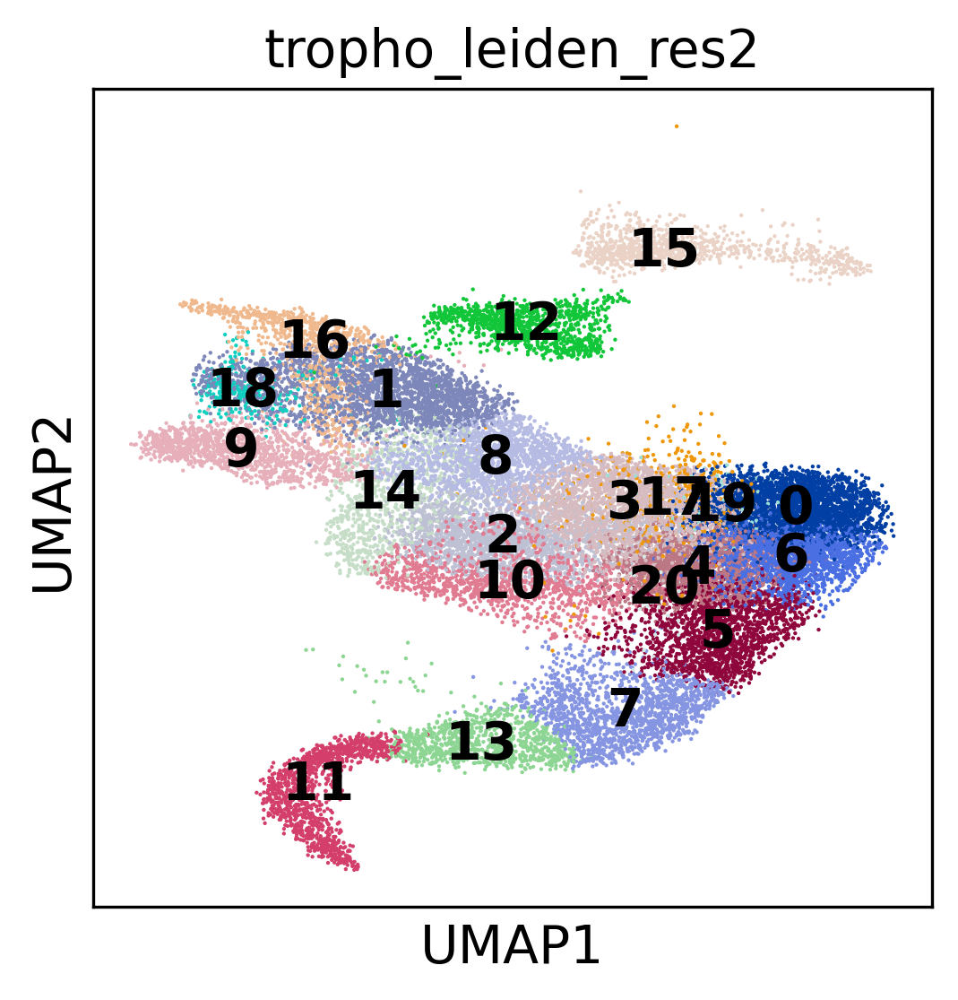

In [82]:
sc.pl.umap(r_tropho,color=["tropho_leiden_res2"],legend_loc="on data")

In [115]:
# Compute 3D UMAP
tropho_3d = sc.pp.neighbors(r_tropho,n_neighbors=25, use_rep="X_pca", random_state=seed, copy=True)
tropho_3d = sc.tl.umap(tropho_3d, min_dist=0.5, n_components=3, random_state=seed, copy=True)
tropho_3d.obs["tropho_leiden_res2"] = r_tropho.obs["tropho_leiden_res2"]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/hps/software/users/marioni/dkeitley/miniconda3/envs/pyenv/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 10002. The TBB threading layer is disabled.
  warnings.warn(problem)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [116]:
# Explore expression against clusters in 3D
fig1 = plotObsUMAP3d(tropho_3d,"CYP19A1",
                     hover_obs=["tropho_leiden_res2","singler","leiden_res8","anatomical_loc","stage","leiden_res8"],
                    colour_map=scrabbit.plot_utils.getCelltypePalette(),figsize=(700,600))

fig2 = plotObsUMAP3d(tropho_3d,"tropho_leiden_res2",
                     hover_obs=["tropho_leiden_res2","singler","anatomical_loc","stage","leiden_res8"],
                     figsize=(700,600))

HBox([go.FigureWidget(fig1), go.FigureWidget(fig2)])

    'data': [{'customdata': array([['2', 'ExE ectoderm', '15', 'Whole embryo', '…

In [ ]:
# Amnion 1
sc.pl.umap(r_tropho, color=["tropho_leiden_res2","VTCN1","TFAP2C","AQP2", "AQP3","CDX2", "PGF","TAC4"],
           color_map="viridis_r", legend_loc="on data")

In [ ]:
# Amnion 2
sc.pl.umap(r_tropho,color=["tropho_leiden_res2", "KRT7", "WNT6", "VTCN1", 
                          "CDO1", "LGALS3"], 
           color_map = "viridis_r", legend_loc = "on data")

In [ ]:
# Amnion 3
sc.pl.umap(r_tropho,color=["tropho_leiden_res2", "GABRP", "ISL1", "WNT6", "LYPD1", "VTCN1", 
                           "ATOX1", "RGS5"], 
           color_map = "viridis_r", legend_loc = "on data")


In [ ]:
# Cytotrophoblast
sc.pl.umap(r_tropho,color=["tropho_leiden_res2","TEAD4","ID2", "HAND1", "WNT2", "CYP19A1", "FGFR2"], 
           color_map = "viridis_r", legend_loc = "on data")

In [ ]:
# Find clusters with earliest GD7 cells
plotObsFraction(r_tropho,obA="GD7", obsA = "stage", obsB = "tropho_leiden_res2", 
                    obsA_ignore_thresh = 50 , obsB_ignore_thresh = 0.02)

In [ ]:
# Trophoblast
sc.pl.umap(r_tropho,color=["tropho_leiden_res2", "TEAD4", "HAND1", "CDX2","HOXA11","BPI"], 
           color_map = "viridis_r", legend_loc = "on data")


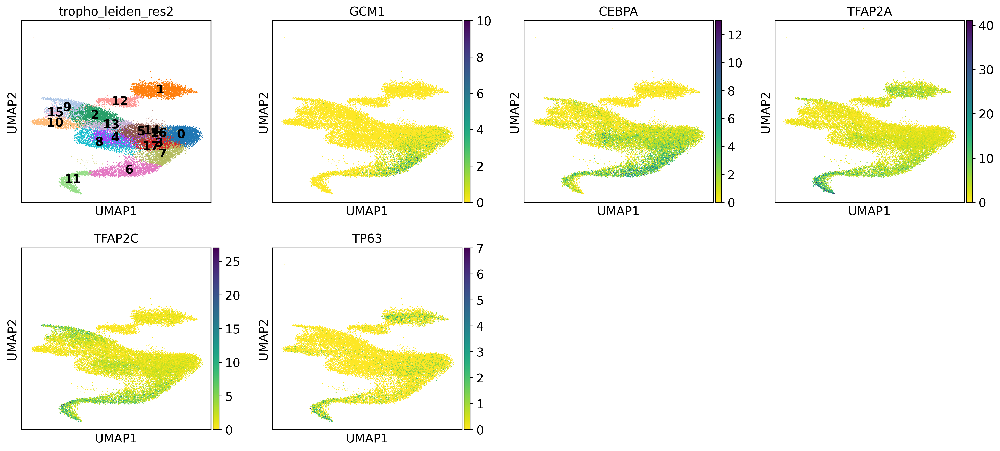

In [33]:
# Syncytiotrophoblast
sc.pl.umap(r_tropho,color=["tropho_leiden_res2", "GCM1", "CEBPA", "TFAP2A","TFAP2C","TP63"], 
           color_map = "viridis_r", legend_loc = "on data")

In [85]:
# Query marker genes
sc.tl.rank_genes_groups(r_tropho,groupby="tropho_leiden_res2",n_genes=30)

/hps/software/users/marioni/dkeitley/miniconda3/envs/pyenv/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (


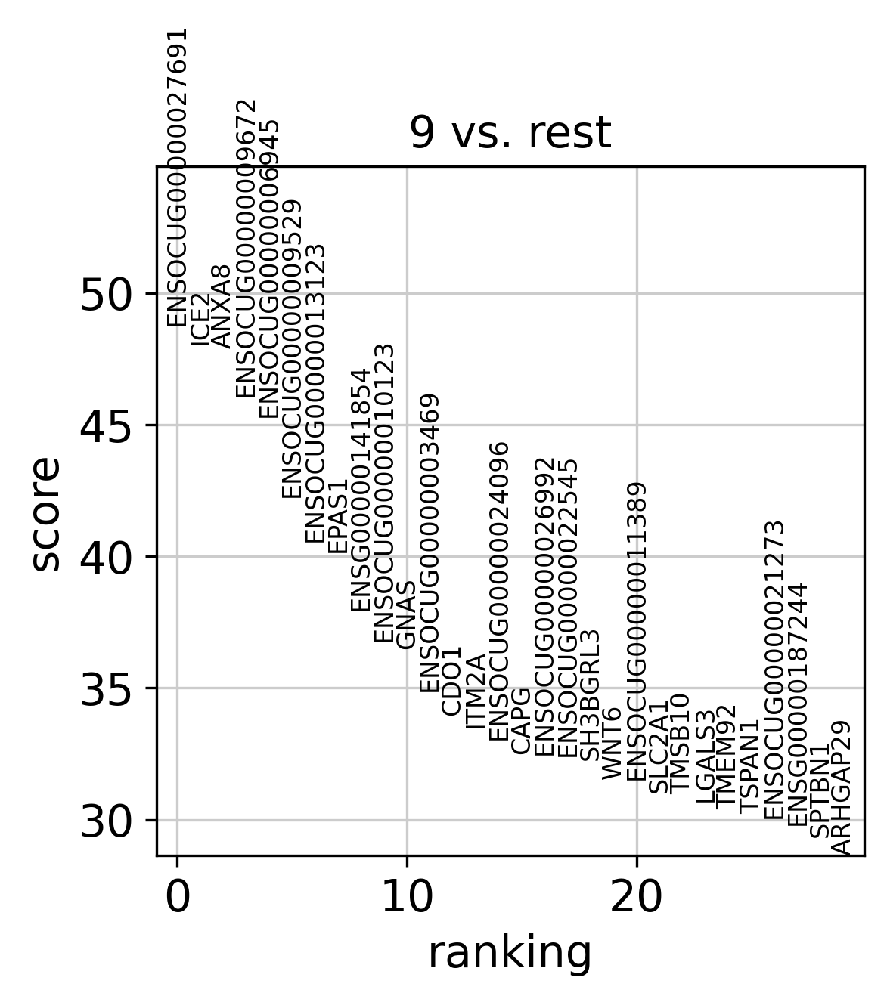

In [88]:
sc.pl.rank_genes_groups(r_tropho,"9",n_genes=30)

In [ ]:
# Plot diff exp markers for each cluster
glist = sc.get.rank_genes_groups_df(r_tropho, group='9')['names'].squeeze().str.strip().tolist()
sc.pl.umap(r_tropho,color=glist[1:30],color_map="viridis_r")

### Hypoblast

In [36]:
r_hypo.var.tail()

,ensembl_id,gene_name,is_human_align_gene
CARNS1_HUMAN,ENSG00000172508,CARNS1_HUMAN,True
TEX54_HUMAN,ENSG00000283268,TEX54_HUMAN,True
SP100_HUMAN,ENSG00000067066,SP100_HUMAN,True
CCDC85B_HUMAN,ENSG00000175602,CCDC85B_HUMAN,True
OR5A2_HUMAN,ENSG00000172324,OR5A2_HUMAN,True


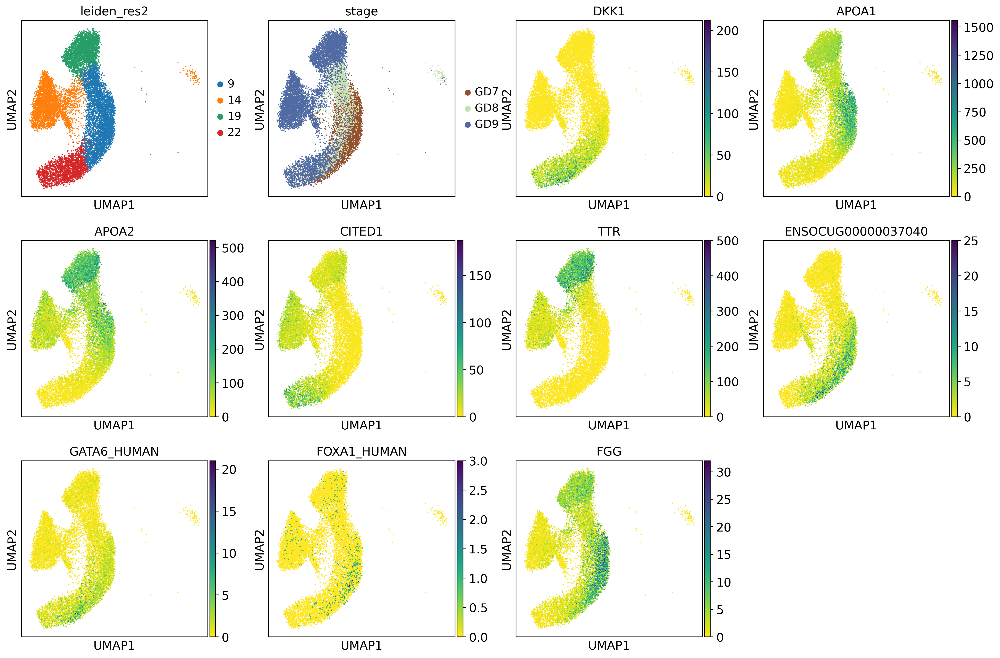

In [41]:
# ENSOCUG00000037040 - SOX17
sc.pl.umap(r_hypo,color=["leiden_res2","stage","DKK1","APOA1","APOA2", "CITED1", "TTR", "ENSOCUG00000037040","GATA6_HUMAN",
                         "FOXA1_HUMAN","FGG"],color_map="viridis_r")

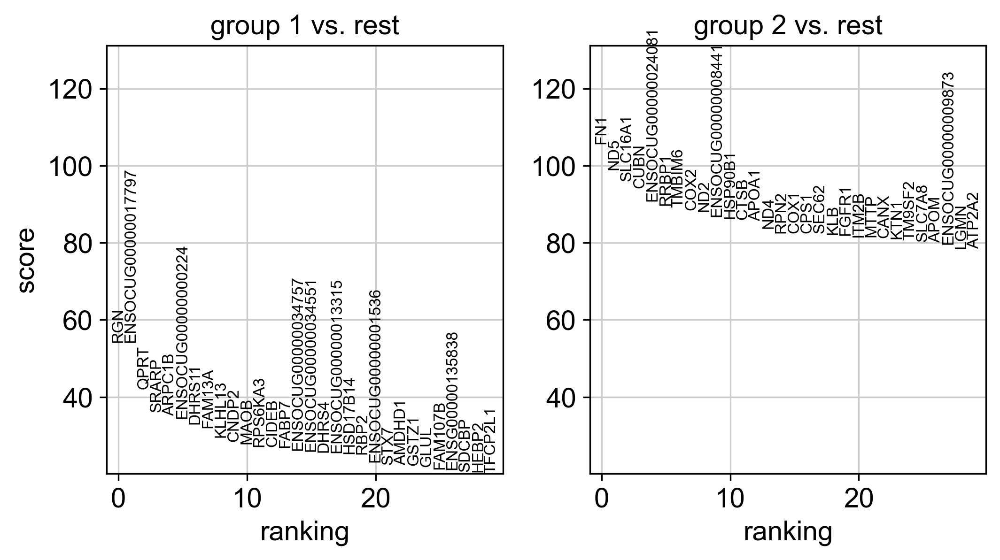

In [853]:
# Find differentially expressed in particular cluster
r_hypo.obs['test_groups'] = ['group 1' if i=="14" else 'group 2' for i in r_hypo.obs['leiden_res2']]
sc.tl.rank_genes_groups(r_hypo, groupby='test_groups')
sc.pl.rank_genes_groups(r_hypo,n_genes=30)

## Assign cell types

By manually inspecting all of this information, we then determine the most-likely identity for each cluster. 

### Mesoderm

In [992]:
#r_meso.obs["assigned_celltype"] = r_meso.obs["assigned_celltype"].astype(str)
r_data.obs["assigned_celltype"] = r_data.obs["assigned_celltype"].astype(str)

r_meso.obs["assigned_celltype"] = "Unknown"

# Perform assignment
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["16"], "assigned_celltype", "Cardiomyocytes FHF 2")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["36"], "assigned_celltype", "Cardiomyocytes FHF 1")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["23","5","47","44"], "assigned_celltype", "Cranial mesoderm")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["10","40"], "assigned_celltype", "Anterior somitic tissues")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["35"], "assigned_celltype", "Anterior cardiopharyngeal progenitors")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["2"], "assigned_celltype", "NMPs/Mesoderm-biased")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["0"], "assigned_celltype", "NMPs")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["12"], "assigned_celltype", "Caudal mesoderm")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["6"], "assigned_celltype", "Presomitic mesoderm")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["18","41"], "assigned_celltype", "Somitic mesoderm")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["3","15","7","4","43","42"], "assigned_celltype", "Dermomyotome")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["17","49"], "assigned_celltype", "Posterior somitic tissues")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["13","21","26","22"], "assigned_celltype", "Sclerotome")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["9","25","24","48","14","1","28","30","31","45"], "assigned_celltype", "Lateral plate mesoderm")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["20"], "assigned_celltype", "Nephron progenitors") # might need to change to kidney primordium
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["32","19"], "assigned_celltype", "Mesothelium") # might need to change to Embryo proper mesothelium
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["33","27","38","39","37","34"], "assigned_celltype", "Cardiopharyngeal progenitors")
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["29","46"], "assigned_celltype", "Mesenchyme") 
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["11"], "assigned_celltype", "Limb mesoderm") 
assignCelltypeAdataSubset(r_data, r_meso, "mesoderm_leiden_res3", ["8"], "assigned_celltype", "Epicardium") 


### Blood

In [820]:
r_blood.obs["assigned_celltype"] = "Unknown"

assignCelltypeAdataSubset(r_data, r_blood, "blood_leiden_res1", ["3","2","9","0","4"], "assigned_celltype", "Erythroid")
assignCelltypeAdataSubset(r_data, r_blood, "blood_leiden_res8", ["10","53","60","32","22","23","57","44","28","51","21"], "assigned_celltype", "Erythroid")
assignCelltypeAdataSubset(r_data, r_blood, "blood_leiden_res8", ["14","19","52"], "assigned_celltype", "Megakariocytes")
assignCelltypeAdataSubset(r_data, r_blood, "blood_leiden_res8", ["37","1"], "assigned_celltype", "EMP")
assignCelltypeAdataSubset(r_data, r_blood, "blood_leiden_res8", ["0","36","58","6","30"], "assigned_celltype", "YS endothelium")
assignCelltypeAdataSubset(r_data, r_blood, "blood_leiden_res8", ["24","5"], "assigned_celltype", "Allantois endothelium")
assignCelltypeAdataSubset(r_data, r_blood, "blood_leiden_res8", ["49"], "assigned_celltype", "Endocardium")
assignCelltypeAdataSubset(r_data, r_blood, "blood_leiden_res8", ["4","8","12","18","3","50","62"], "assigned_celltype", "Venous endothelium")
assignCelltypeAdataSubset(r_data, r_blood, "blood_leiden_res8", ["2"], "assigned_celltype", "MEP")
assignCelltypeAdataSubset(r_data, r_blood, "blood_leiden_res8", ["55","29"], "assigned_celltype", "Embryo proper endothelium")

### Extra-embryonic mesoderm

In [1000]:
r_exeMeso.obs["assigned_celltype"] = "Unknown"

assignCelltypeAdataSubset(r_data, r_exeMeso, "exeMeso_leiden_res1", ["0","1","9"], "assigned_celltype", "Mesothelium")
assignCelltypeAdataSubset(r_data, r_exeMeso, "exeMeso_leiden_res1", ["10"], "assigned_celltype", "Mesothelium-endothelium/Masked")
assignCelltypeAdataSubset(r_data, r_exeMeso, "exeMeso_leiden_res1", ["3","4"], "assigned_celltype", "Allantois")
assignCelltypeAdataSubset(r_data, r_exeMeso, "exeMeso_leiden_res1", ["8","7","2","5","6"], "assigned_celltype", "Mesenchyme")

### Neural

In [450]:
r_neural.obs["assigned_celltype"] = "Unknown"

assignCelltypeAdataSubset(r_data, r_neural, "neural_leiden_res3", ["17"], "assigned_celltype", "Floor plate")
assignCelltypeAdataSubset(r_data, r_neural, "neural_leiden_res3", ["16"], "assigned_celltype", "Differentiating neurons")
assignCelltypeAdataSubset(r_data, r_neural, "neural_leiden_res3", ["22"], "assigned_celltype", "Roof plate")

assignCelltypeAdataSubset(r_data, r_neural, "neural_leiden_res3", ["2", "15", "5", "9", "14"], "assigned_celltype", "Forebrain")
assignCelltypeAdataSubset(r_data, r_neural, "neural_leiden_res3", ["12", "19", "10", "7"], "assigned_celltype", "Midbrain")
assignCelltypeAdataSubset(r_data, r_neural, "neural_leiden_res3", ["1", "8", "18", "4", "20", "21", "3", "11"], "assigned_celltype", "Hindbrain")
assignCelltypeAdataSubset(r_data, r_neural, "neural_leiden_res3", ["6","0","13"], "assigned_celltype", "Spinal cord")

sc.pl.umap(r_neural,color="assigned_celltype")

### Trophoblast


In [1084]:
r_tropho.obs["assigned_celltype"] = r_tropho.obs["assigned_celltype"].astype(str)
r_data.obs["assigned_celltype"] = r_data.obs["assigned_celltype"].astype(str)

r_tropho.obs["assigned_celltype"] = "Unknown"

r_tropho.obs["assigned_celltype"] = r_tropho.obs["assigned_celltype"].astype(str)
r_data.obs["assigned_celltype"] = r_data.obs["assigned_celltype"].astype(str)

assignCelltypeAdataSubset(r_data, r_tropho, "tropho_leiden_res2", ["16","1","18"], "assigned_celltype", "Amnion 1") 
assignCelltypeAdataSubset(r_data, r_tropho, "tropho_leiden_res2", ["9", "8"], "assigned_celltype", "Amnion 2") 
assignCelltypeAdataSubset(r_data, r_tropho, "tropho_leiden_res2", ["12"], "assigned_celltype", "Amnion 3") 

assignCelltypeAdataSubset(r_data, r_tropho, "tropho_leiden_res2", ["13","7","5"], "assigned_celltype", "Syncytiotrophoblast progenitors") 
assignCelltypeAdataSubset(r_data, r_tropho, "tropho_leiden_res2", ["11"], "assigned_celltype", "Syncytiotrophoblast")

assignCelltypeAdataSubset(r_data, r_tropho, "tropho_leiden_res2", ["0","6","19","4","20","17","3"], "assigned_celltype", "Cytotrophoblast") 

assignCelltypeAdataSubset(r_data, r_tropho, "tropho_leiden_res2", ["2","10","14"], "assigned_celltype", "Trophoblast") 
assignCelltypeAdataSubset(r_data, r_tropho, "tropho_leiden_res2", ["15"], "assigned_celltype", "Non-neural ectoderm 2") 

### Miscellaneous

In [1087]:
r_misc.obs["assigned_celltype"] = r_misc.obs["assigned_celltype"].astype(str)
r_nc.obs["assigned_celltype"] = r_nc.obs["assigned_celltype"].astype(str)
r_data.obs["assigned_celltype"] = r_data.obs["assigned_celltype"].astype(str)

r_misc.obs["assigned_celltype"] = "Unknown"

# Leiden res 3
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["22"], "assigned_celltype", "Notochord")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["26"], "assigned_celltype", "PGC")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["10"], "assigned_celltype", "Anterior Primitive Streak")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["8"], "assigned_celltype", "Nascent mesoderm")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["4","2","17"], "assigned_celltype", "Epiblast")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["20","7","25"], "assigned_celltype", "Primitive Streak")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["19"], "assigned_celltype", "Visceral endoderm")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["23"], "assigned_celltype", "Thyroid primordium")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["21"], "assigned_celltype", "Definitive Endoderm")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["13"], "assigned_celltype", "Gut endoderm")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["11"], "assigned_celltype", "Gut tube")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["0","3"], "assigned_celltype", "Pharyngeal endoderm")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["5","16"], "assigned_celltype", "Placodal ectoderm")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["24","14"], "assigned_celltype", "Non-neural ectoderm 2")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["15","18","9"], "assigned_celltype", "Non-neural ectoderm 4")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res3", ["12"], "assigned_celltype", "Nascent mesoderm")

# Leiden res 4
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res4", ["26"], "assigned_celltype", "Nascent mesoderm")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res4", ["16"], "assigned_celltype", "Haematoendothelial progenitors")
assignCelltypeAdataSubset(r_data, r_misc, "misc_leiden_res4", ["23","27","32"], "assigned_celltype", "Placodal ectoderm")

# Neural crest
assignCelltypeAdataSubset(r_data, r_nc, "nc_leiden_res1", ["0","2"], "assigned_celltype", "Cranial neural crest")
assignCelltypeAdataSubset(r_data, r_nc, "nc_leiden_res1", ["1","3","4","5"], "assigned_celltype", "Migratory neural crest")



### Hypoblast

In [856]:
r_hypo.obs["assigned_celltype"] = r_hypo.obs["assigned_celltype"].astype(str)
r_data.obs["assigned_celltype"] = r_data.obs["assigned_celltype"].astype(str)

r_hypo.obs["assigned_celltype"] = "Unknown"

assignCelltypeAdataSubset(r_data, r_hypo, "leiden_res2", ["22"], "assigned_celltype", "Parietal YS endoderm")
assignCelltypeAdataSubset(r_data, r_hypo, "leiden_res2", ["9"], "assigned_celltype", "Hypoblast")
assignCelltypeAdataSubset(r_data, r_hypo, "leiden_res2", ["19"], "assigned_celltype", "Visceral YS endoderm")
assignCelltypeAdataSubset(r_data, r_hypo, "leiden_res2", ["14"], "assigned_celltype", "Visceral YS endoderm 2")

In [1090]:
# Save annotations to file
r_data.obs["assigned_celltype"].to_csv("data-out/celltype_annotation/annotations_08-03-22.tsv",sep="\t")

### Plot non ExE-ecotderm cell types


In [1088]:
r_data.obs["assigned_celltype"] = r_data.obs["assigned_celltype"].astype(str)
r_data.obs["assigned_celltype"].loc[r_data.obs["assigned_celltype"] == "nan"]="Unknown"
r_data.obs["assigned_celltype"].loc[(r_data.obs["leiden_res1"].isin(["0","16","9"])) & (r_data.obs["assigned_celltype"]=="Unknown")]="Trophoblast"

C:\anaconda\envs\rabbit-gastrulation-python\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [242]:
r_data.obs["fig2_annotations"] = r_data.obs["assigned_celltype"].astype(str)
r_data.obs["fig2_annotations"][r_data.obs["fig2_annotations"].isin(["Syncytiotrophoblast", "Syncytiotrophoblast progenitors", "Amnion 1", "Cytotrophoblast",
                                              "Amnion 3","Amnion 2","Trophoblast"])] = "ExE ectoderm"

<ipython-input-242-f1357a22ba5d>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



/hps/software/users/marioni/dkeitley/miniconda3/envs/pyenv/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



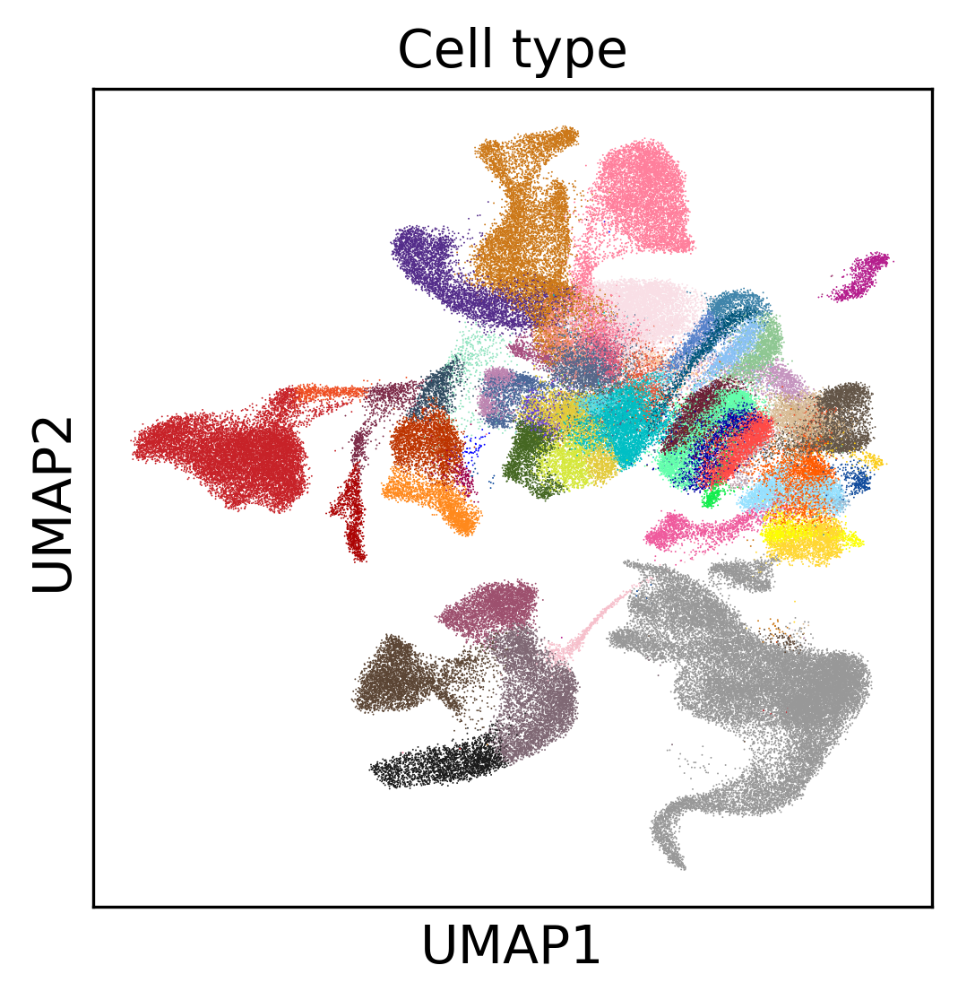

In [245]:
# Figure 2C
sc.pl.umap(r_data,color="fig2_annotations",palette=scrabbit.plot_utils.getCelltypePalette(), 
           title="Cell type", legend_loc="none", save="_fig2_celltype_umap_noleg.pdf")

### Plot all cell types

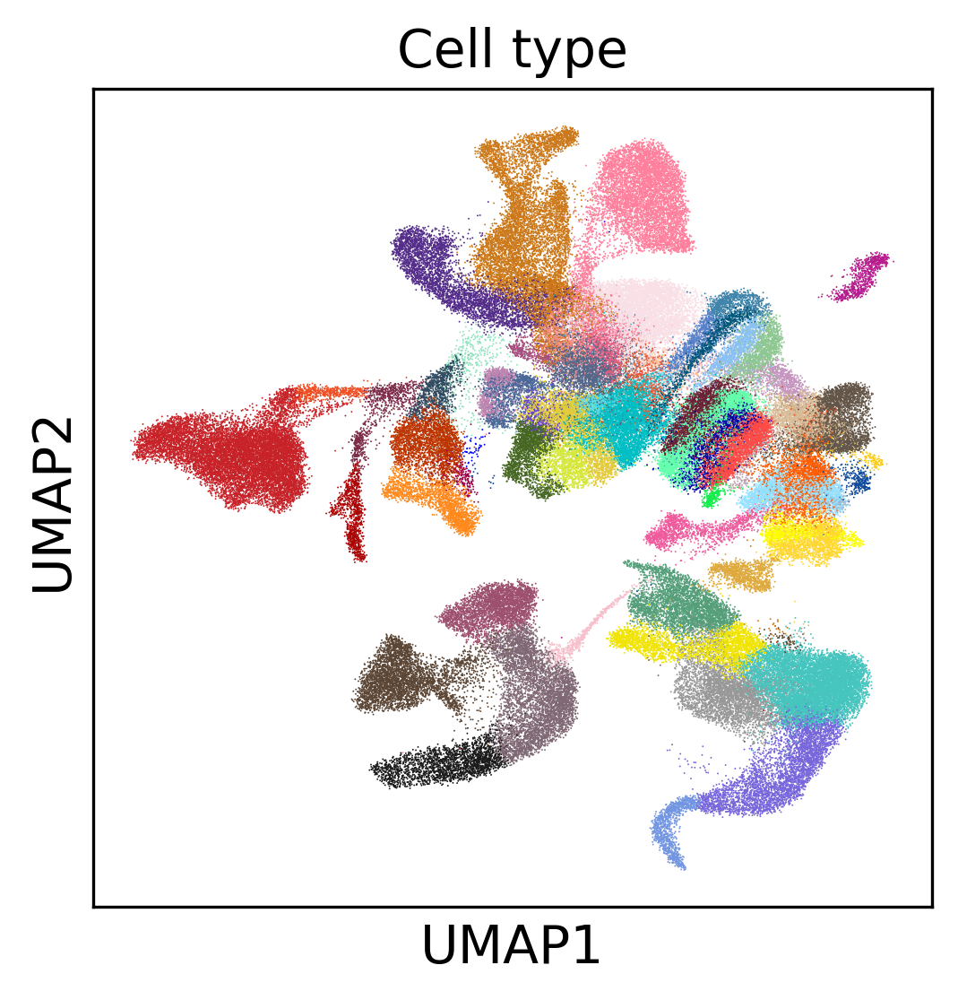

In [374]:
sc.pl.umap(r_data, color="assigned_celltype", palette = scrabbit.plot_utils.getCelltypePalette(),
           title="Cell type",legend_loc="none", save="_fig1_all_celltypes_umap_noleg.pdf")